### Данные

В датасете содержится информация с публичных слушаний Москвы по правилам землепользования и застройки (ПЗЗ). В них комментарии жителей города были застенагрофированы, проклассифицированы (за/против) и нанесены на карту. Данные предоставлены в 2 вариантах, для задания можно использовать любой:

* **comment** - комментарий одного или списка жителей к проект
* **multiplier** - количество авторов комментария (может быть 1, может быть список)
* **x, y** - координаты адреса, по которому был дан определённой комментарий
* **comment_class** - за (1) / против (-1)

### Задача

* визуально разделить город на районы безотносительно голосов 
* аналогично исследовать скопления голосов за и против отдельно
* подобрать оптимальное число кластеров 


In [3]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
%matplotlib inline
import seaborn as sns
from tqdm import tqdm

import folium as fo

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, AffinityPropagation, Birch
from sklearn.metrics import silhouette_score

import matplotlib.cm as cm
import matplotlib.colors as colors

In [4]:
df = pd.read_excel('geo_comment.xlsx')
df.head()

,Unnamed: 0,x,y,comment_class,multiplier,comment
0,0,37.612416,55.777454,-1,1,Во все разделы правил землепользования и застр...
1,1,37.612416,55.777454,-1,1,На основании вступившего в законную силу судеб...
2,2,37.603298,55.742108,-1,1,Внести в Проект правил землепользования и заст...
3,3,37.558526,55.728758,-1,1,Учитывая социальную значимость проекта строите...
4,4,37.566431,55.731794,-1,1,Учитывая социальную значимость проекта строите...


In [5]:
df.drop(['Unnamed: 0'], axis=1, inplace=True)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70382 entries, 0 to 70381
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   x              70382 non-null  float64
 1   y              70382 non-null  float64
 2   comment_class  70382 non-null  int64  
 3   multiplier     70382 non-null  int64  
 4   comment        70382 non-null  object 
dtypes: float64(2), int64(2), object(1)
memory usage: 2.7+ MB


В данных отстутствуют пропуски, обработка отсутствующих значений не требуется

In [7]:
df.describe()

,x,y,comment_class,multiplier
count,70382.000000,70382.000000,70382.000000,70382.000000
mean,37.588417,55.786013,-0.663835,1.545935
std,0.138217,0.066225,0.747885,16.986786
min,37.148813,55.496939,-1.000000,1.000000
25%,37.445608,55.743558,-1.000000,1.000000
50%,37.570887,55.792331,-1.000000,1.000000
75%,37.702822,55.848665,-1.000000,1.000000
max,37.931228,55.994174,1.000000,1500.000000


Показатель std у признаков 'x' и 'y' невелик, разброс значений не очень большой. Скорее всего, ярко выраженных выбросов будет мало или не будет в принципе

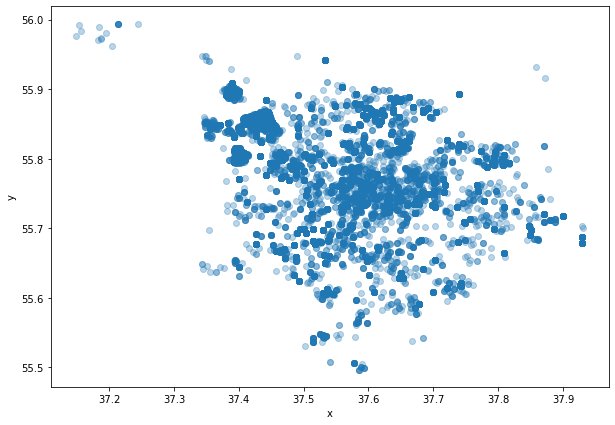

In [8]:
plt.figure(figsize=(10,7))
plt.scatter(df['x'], df['y'], alpha=0.3)
plt.xlabel('x')
plt.ylabel('y')
plt.show()


Тем не менее видим небольшое скопление точек в левом верхнем углу карты, которое похоже на выбросы, но скорее всего будет определено как маленький отдельный кластер (все же точек несколько и видно, что они сгруппированны, хоть и не очень плотно).

Глядя на оставшуюся часть графика, сложно сказать, на сколько кластеров должны быть разбиты данные

In [10]:
# для наглядности можно нанести геокоординаты на реальную карту
Map=fo.Map([df.y.median(), df.x.median()],zoom_start=10)

df_sample = df.sample(10000) # возьмем часть данных для более быстрого выполнения 
 
for ind in df_sample.index:
    long=df_sample.loc[ind,'x']
    lat=df_sample.loc[ind,'y']
    fo.CircleMarker([lat, long],radius=1, opacity=0.5).add_to(Map)
Map

Теперь понятно, что наши потенциальные выбросы относятся к Зеленограду. Довольно плотные скопления точек просматриваются в районе Химок и Красногорска, ожидаемо много точек относятся к центральной части Москвы. 

### K-means

Начнем с простого алгоритма. Количество кластеров зададим произвольно: не слишком большое, но и не маленькое

In [11]:
df_coords = df[['x', 'y']]

In [12]:
kmeans = KMeans(n_clusters=6)
clusters = kmeans.fit_predict(df_coords)

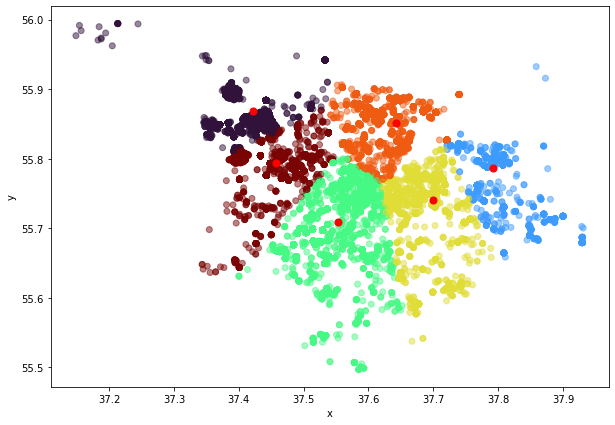

In [13]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters, alpha=0.5, cmap='turbo')
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], s=50, color='r')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

Попробуем рассчитать оптимальное количество кластеров, чтобы получить более репрезентативную картинку

In [14]:
k_inertia = []
ks = range(1,21)

for k in ks:
    clf_kmeans = KMeans(n_clusters=k)
    clusters_kmeans = clf_kmeans.fit_predict(df_coords, )
    k_inertia.append(clf_kmeans.inertia_)

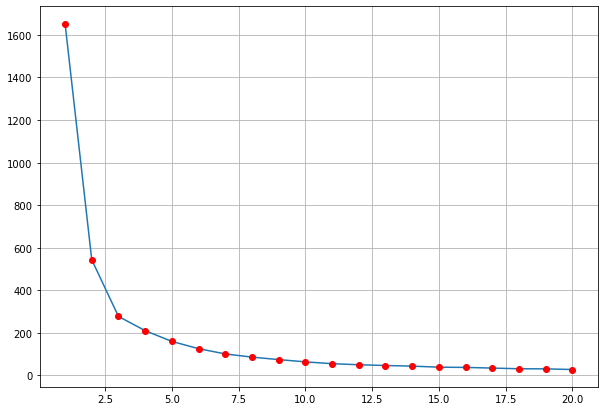

In [15]:
plt.figure(figsize=(10,7))
plt.plot(ks, k_inertia)
plt.plot(ks, k_inertia, 'ro')
plt.grid()

Точку максимальной кривизны полученного графика сложно определиь однозначно. Я бы сказала, что оптимальным количеством кластеров исходя из формы кривой будет являться 4 или 5 кластеров. После прохождения точки 5 кривая убывает уже более плавно, изменения значений в новых точках незначительно  

In [16]:
kmeans_5 = KMeans(n_clusters=5)
clusters_5 = kmeans_5.fit_predict(df_coords)

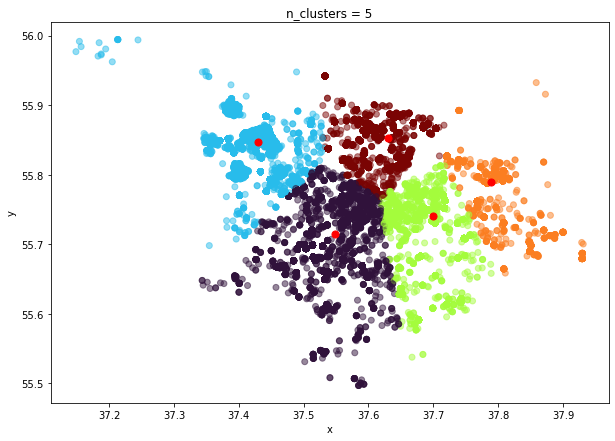

In [17]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters_5, alpha=0.5, cmap='turbo')
centers = kmeans_5.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], s=50, color='r')
plt.xlabel('x')
plt.ylabel('y')
plt.title('n_clusters = 5')
plt.show()

In [18]:
kmeans_4 = KMeans(n_clusters=4)
clusters_4 = kmeans_4.fit_predict(df_coords)

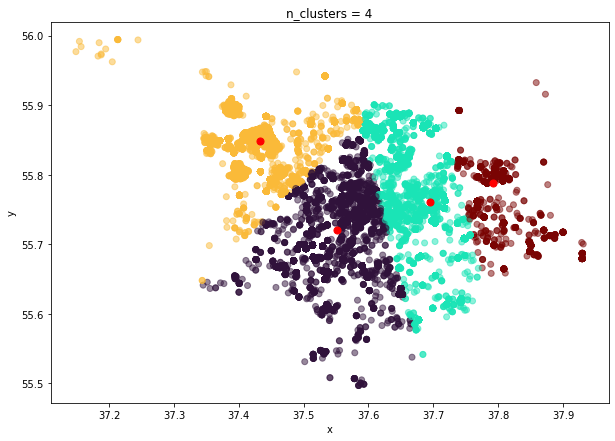

In [19]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters_4, alpha=0.5, cmap='turbo')
centers = kmeans_4.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], s=50, color='r')
plt.xlabel('x')
plt.ylabel('y')
plt.title('n_clusters = 4')
plt.show()

При сравнении двух этих вариантов более логичным кажется разбиение на 5 кластеров: деление на 4 дает слишком крупные объединения точек. Попробуем нанести метки, размеченные по кластерам, на карту.

In [20]:
df_copy = df_coords.copy()

In [21]:
np.unique(clusters_5)

array([0, 1, 2, 3, 4])

In [22]:
df_copy['color'] = clusters_5

In [23]:
colors_array = cm.turbo(np.linspace(0, 1, len(np.unique(clusters))))
rainbow = [colors.rgb2hex(i) for i in colors_array]

Выделим сэмпл данных с сохранением пропорций кластеров для нанесения на карту

In [33]:
df_copy.color.value_counts()

1    23594
2    17935
0    13722
3    10523
4     4608
Name: color, dtype: int64

In [42]:
df_sample = df_copy.groupby('color', group_keys=False).apply(lambda x: x.sample(frac=0.2))
df_sample.head()

,x,y,color
22331,37.570887,55.741389,0
48328,37.532565,55.649576,0
22001,37.570887,55.741389,0
20377,37.570887,55.741389,0
2211,37.509990,55.637672,0


In [43]:
df_sample.color.value_counts()

1    4719
2    3587
0    2744
3    2105
4     922
Name: color, dtype: int64

In [44]:
Map=fo.Map([df_copy.y.median(), df_copy.x.median()],zoom_start=10)
 
for ind in df_sample.index:
    cluster = df_sample.loc[ind,'color']
    long=df_sample.loc[ind,'x']
    lat=df_sample.loc[ind,'y']
    fo.CircleMarker([lat, long], 
                    radius=1, 
                    color=rainbow[cluster+1],
                    fill=True,
                    fill_color=rainbow[cluster+1],
                    opacity=0.5).add_to(Map)
    
Map

В целом, разбиение на 5 кластеров неплохо легло на реальную карту, границы кластеров проходят рядом с крупными дорогами. Однако возможно, что для такого крупного города, как Москва, 5 кластеров недостаточно,  можно попробовать применить другие алгоритмы кластеризации, чтобы увидеть 

### DBSCAN

Неизвестно, сколько кластеров даст на выходе DBSCAN. Исходя из результатов K-means, будем рассчитывать на то, что их в результате должно быть не меньше 5.

In [45]:
def print_results(data, clusters, min_samples, eps):
    '''Вывод количества кластеров и Silhoette-score для заданных параметров DBSCAN'''
    s_score = silhouette_score(data, clusters)
    print(f'eps = {eps}, min_samples = {min_samples}, \nnum of clusters = {len(np.unique(clusters))},\nsilhouette score = {s_score}')
    print()
    

Запустим пробный алгоритм. Т.к. для такого количества данных рассчитываем найти достаточно крупные скопления точек, не будем использовать min_samples по умолчанию, а сразу увеличим этот параметр.

In [22]:
eps, min_samples = 0.1, 500
dbscan = DBSCAN(eps=eps, min_samples=min_samples, n_jobs=-1)
clusters = dbscan.fit_predict(df_coords)

In [23]:
print_results(df_coords, clusters, min_samples, eps)

eps = 0.1, min_samples = 500, 
num of clusters = 2,
silhouette score = 0.5278926756211458



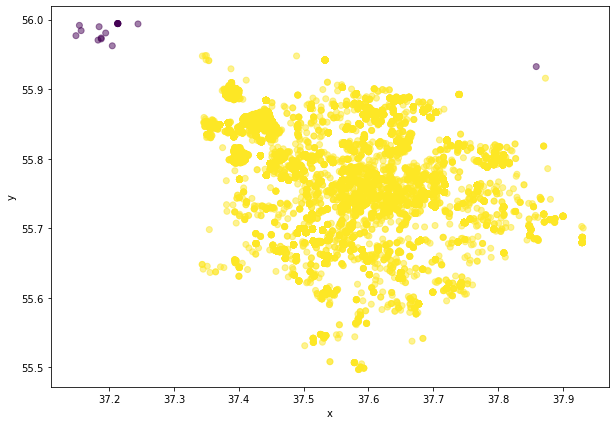

In [26]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters, alpha=0.5)
plt.xlabel('x')
plt.ylabel('y')
plt.show()

Результат логичный, но практического смысла почти не имеющий. Будем подбирать параметры, которые дадут более полезную разбивку.

In [45]:
eps_list = [0.005, 0.01, 0.05, 0.1]
min_samples_list = [250, 500, 1000]

for eps in eps_list:
    for min_samples in min_samples_list:
        
        dbscan = DBSCAN(eps=eps, min_samples=min_samples, n_jobs=-1)
        clusters = dbscan.fit_predict(df_coords)
        print_results(df_coords, clusters, min_samples, eps)
        


eps = 0.005, min_samples = 250, 
num of clusters = 48,
silhouette score = 0.6427591499912155

eps = 0.005, min_samples = 500, 
num of clusters = 27,
silhouette score = 0.46713189586425885

eps = 0.005, min_samples = 1000, 
num of clusters = 15,
silhouette score = 0.31187305541327803

eps = 0.01, min_samples = 250, 
num of clusters = 29,
silhouette score = 0.603938631771847

eps = 0.01, min_samples = 500, 
num of clusters = 22,
silhouette score = 0.5514757328994757

eps = 0.01, min_samples = 1000, 
num of clusters = 12,
silhouette score = 0.41684655491319045

eps = 0.05, min_samples = 250, 
num of clusters = 2,
silhouette score = 0.4564487328807607

eps = 0.05, min_samples = 500, 
num of clusters = 2,
silhouette score = 0.3594540133070105

eps = 0.05, min_samples = 1000, 
num of clusters = 2,
silhouette score = 0.2950327336068632

eps = 0.1, min_samples = 250, 
num of clusters = 2,
silhouette score = 0.5278926756211458

eps = 0.1, min_samples = 500, 
num of clusters = 2,
silhouette scor

При увеличении эпсилон получаем на выходе 2 кластера, что по сути совпадает с первым запуском алгоритма и не является полезным результатом.

Посмотрим на разбивку с самым высоким silhouette-score

In [46]:
eps, min_samples = 0.005, 250
dbscan = DBSCAN(eps=eps, min_samples=min_samples, n_jobs=-1)
clusters = dbscan.fit_predict(df_coords)

In [47]:
print_results(df_coords, clusters, min_samples, eps)

eps = 0.005, min_samples = 250, 
num of clusters = 48,
silhouette score = 0.6427591499912155



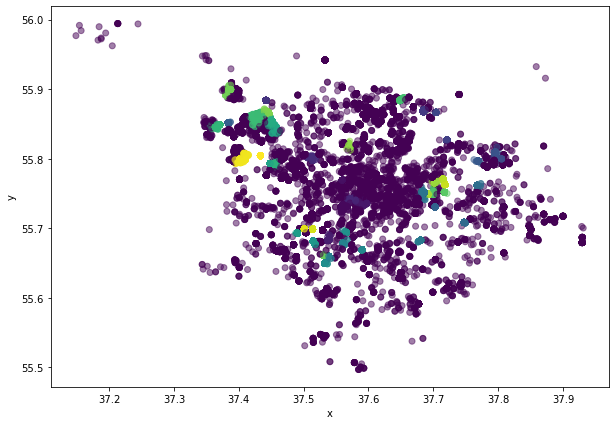

In [48]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters, alpha=0.5)
plt.xlabel('x')
plt.ylabel('y')
plt.show()

Такие параметры дают слишком много мелких кластеров, хотелось бы получить более крупные группы точек. 
Продолжим подбор параметров в тех диапазонах, в которых в результате получалось порядка 10-20 кластеров

In [49]:
eps_list = [0.005, 0.01, 0.02, 0.03]
min_samples_list = [250, 500, 750, 1000]

for eps in eps_list:
    for min_samples in min_samples_list:
        
        dbscan = DBSCAN(eps=eps, min_samples=min_samples, n_jobs=-1)
        clusters = dbscan.fit_predict(df_coords)
        print_results(df_coords, clusters, min_samples, eps)

eps = 0.005, min_samples = 250, 
num of clusters = 48,
silhouette score = 0.6427591499912155

eps = 0.005, min_samples = 500, 
num of clusters = 27,
silhouette score = 0.46713189586425885

eps = 0.005, min_samples = 750, 
num of clusters = 18,
silhouette score = 0.3353320458624564

eps = 0.005, min_samples = 1000, 
num of clusters = 15,
silhouette score = 0.31187305541327803

eps = 0.01, min_samples = 250, 
num of clusters = 29,
silhouette score = 0.603938631771847

eps = 0.01, min_samples = 500, 
num of clusters = 22,
silhouette score = 0.5514757328994757

eps = 0.01, min_samples = 750, 
num of clusters = 16,
silhouette score = 0.457323552519759

eps = 0.01, min_samples = 1000, 
num of clusters = 12,
silhouette score = 0.41684655491319045

eps = 0.02, min_samples = 250, 
num of clusters = 11,
silhouette score = 0.3643464199580223

eps = 0.02, min_samples = 500, 
num of clusters = 11,
silhouette score = 0.36495077488876954

eps = 0.02, min_samples = 750, 
num of clusters = 11,
silhouet

По соотношению скора и количества кластеров наиболее перспективным кажется запуск DBSCAN с параметрами eps=0.02, min_samples=1000, в результате которого получилось 10 групп и silhouette score = 0.514

In [46]:
eps, min_samples = 0.02, 1000
dbscan = DBSCAN(eps=eps, min_samples=min_samples, n_jobs=-1)
clusters = dbscan.fit_predict(df_coords)

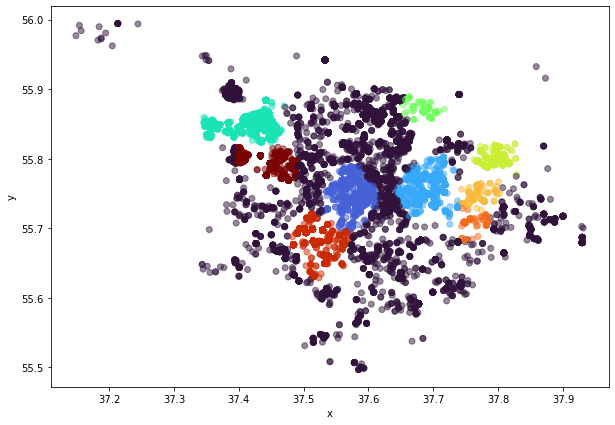

In [47]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters, alpha=0.5, cmap='turbo')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

Визуализируем на карте

In [48]:
df_copy = df_coords.copy()

In [49]:
df_copy['color'] = clusters
df_copy.head()

,x,y,color
0,37.612416,55.777454,-1
1,37.612416,55.777454,-1
2,37.603298,55.742108,0
3,37.558526,55.728758,0
4,37.566431,55.731794,0


In [50]:
colors_array = cm.turbo(np.linspace(0, 1, len(np.unique(clusters))))

In [51]:
rainbow = [colors.rgb2hex(i) for i in colors_array]

In [52]:
Map=fo.Map([df_copy.y.median(), df_copy.x.median()],zoom_start=10)

df_sample = df_copy.groupby('color', group_keys=False).apply(lambda x: x.sample(frac=0.2))
 
for ind in df_sample.index:
    cluster = df_sample.loc[ind,'color']
    long=df_sample.loc[ind,'x']
    lat=df_sample.loc[ind,'y']
    fo.CircleMarker([lat, long], 
                    radius=1, 
                    color=rainbow[cluster+1],
                    fill=True,
                    fill_color=rainbow[cluster+1],
                    opacity=0.5).add_to(Map)
    
Map

### Other algorithms

Сделан пробный запуск алгоритмов Affinity Propagation и Agglomerative Clustering, но на таком объеме данных оба падают с ошибкой нехватки памяти. Пробуем алгоритм Birch

In [182]:
# первый запуск
model = Birch(n_clusters=10, threshold=0.1)
clusters = model.fit_predict(df_coords)

C:\Users\Polina.DESKTOP-UGBOPLJ\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:647: ConvergenceWarning: Number of subclusters found (7) by Birch is less than (10). Decrease the threshold.
  warnings.warn(


В дальнейшем необходимо уменьшить threshold

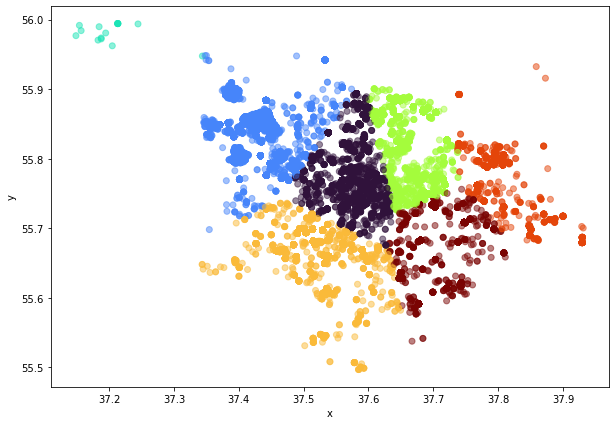

In [183]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters, alpha=0.5, cmap='turbo')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [185]:
# подбор параметров
thresholds_list = [0.01, 0.03, 0.05]
n_clusters_list = list(range(10, 16))

for threshold in thresholds_list:
    for n_clusters in n_clusters_list:
        
        birch = Birch(n_clusters=n_clusters, threshold=threshold)
        clusters = birch.fit_predict(df_coords)
        s_score = silhouette_score(df_coords, clusters)
        print(f'threshold = {threshold}, \nnum of clusters = {n_clusters},\nsilhouette score = {s_score}')
        print()

threshold = 0.01, 
num of clusters = 10,
silhouette score = 0.5429759929248639

threshold = 0.01, 
num of clusters = 11,
silhouette score = 0.5341968125096894

threshold = 0.01, 
num of clusters = 12,
silhouette score = 0.5356576037036901

threshold = 0.01, 
num of clusters = 13,
silhouette score = 0.5320615700235651

threshold = 0.01, 
num of clusters = 14,
silhouette score = 0.5394437295292647

threshold = 0.01, 
num of clusters = 15,
silhouette score = 0.5296464155792014

threshold = 0.03, 
num of clusters = 10,
silhouette score = 0.5235495380812214

threshold = 0.03, 
num of clusters = 11,
silhouette score = 0.5436722556731516

threshold = 0.03, 
num of clusters = 12,
silhouette score = 0.545760457355432

threshold = 0.03, 
num of clusters = 13,
silhouette score = 0.5341162469781541

threshold = 0.03, 
num of clusters = 14,
silhouette score = 0.5315023079432214

threshold = 0.03, 
num of clusters = 15,
silhouette score = 0.5299327119108362

threshold = 0.05, 
num of clusters = 10,


In [53]:
# модель с наибольшим silhouette score
model = Birch(n_clusters=14, threshold=0.05)
clusters = model.fit_predict(df_coords)

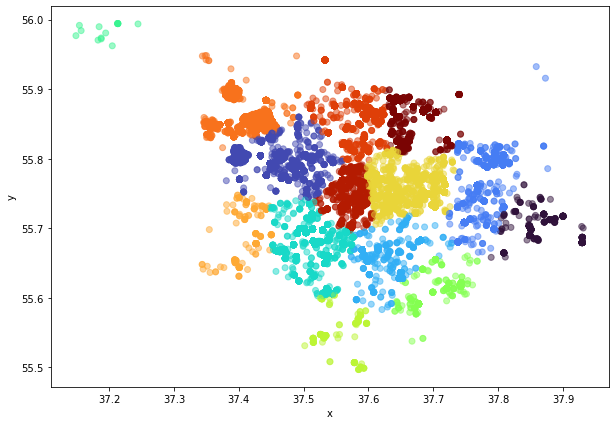

In [54]:
plt.figure(figsize=(10,7))
plt.scatter(df_coords.iloc[:, 0], df_coords.iloc[:, 1],c=clusters, alpha=0.5, cmap='turbo')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [55]:
df_copy['color'] = clusters
df_copy.head()

colors_array = cm.turbo(np.linspace(0, 1, len(np.unique(clusters))))
rainbow = [colors.rgb2hex(i) for i in colors_array]

In [56]:
Map=fo.Map([df_copy.y.median(), df_copy.x.median()],zoom_start=10)

df_sample = df_copy.groupby('color', group_keys=False).apply(lambda x: x.sample(frac=0.2))
 
for ind in df_sample.index:
    cluster = df_sample.loc[ind,'color']
    long=df_sample.loc[ind,'x']
    lat=df_sample.loc[ind,'y']
    fo.CircleMarker([lat, long], 
                    radius=1, 
                    color=rainbow[cluster],
                    fill=True,
                    fill_color=rainbow[cluster],
                    opacity=0.5).add_to(Map)
    
Map

Для деления геоданных на городские районы такой вариант кажется наиболее удачным 

#### Исследуем голоса за и против по отдельности

Будем сразу применять метод Birch

In [195]:
# разделим датасет на подгруппы "за" и "против"
df_yes = df[df.comment_class == 1]
df_no = df[df.comment_class == -1]

In [196]:
df_yes = df_yes[['x', 'y']]
df_no = df_no[['x', 'y']]

In [197]:
print(df_yes.shape)
print(df_no.shape)

(11830, 2)
(58552, 2)


In [198]:
# подбор параметров для голосов "за"

thresholds_list = [0.01, 0.03, 0.05]
n_clusters_list = list(range(10, 16))

threshold_best = 0
n_clustres_best = 0
score_best = 0

for threshold in thresholds_list:
    for n_clusters in n_clusters_list:
        
        birch = Birch(n_clusters=n_clusters, threshold=threshold)
        clusters = birch.fit_predict(df_yes)
        s_score = silhouette_score(df_yes, clusters)
        
        if s_score > score_best:
            score_best = s_score
            threshold_best = threshold
            n_clustres_best = n_clusters
        
        
print(f'threshold = {threshold_best}, \nnum of clusters = {n_clustres_best},\nsilhouette score = {score_best}')
print()

threshold = 0.05, 
num of clusters = 11,
silhouette score = 0.7594874145337807



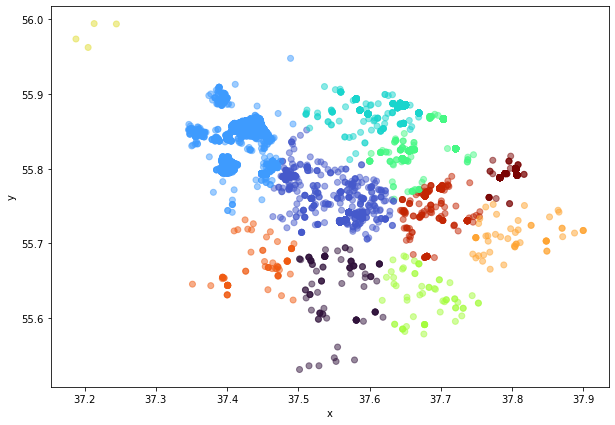

In [200]:
# модель с наибольшим silhouette score
model = Birch(n_clusters=n_clustres_best, threshold=threshold_best)
clusters = model.fit_predict(df_yes)

plt.figure(figsize=(10,7))
plt.scatter(df_yes.iloc[:, 0], df_yes.iloc[:, 1],c=clusters, alpha=0.5, cmap='turbo')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [201]:
# подбор параметров для голосов "против"

thresholds_list = [0.01, 0.03, 0.05]
n_clusters_list = list(range(10, 16))

threshold_best = 0
n_clustres_best = 0
score_best = 0

for threshold in thresholds_list:
    for n_clusters in n_clusters_list:
        
        birch = Birch(n_clusters=n_clusters, threshold=threshold)
        clusters = birch.fit_predict(df_no)
        s_score = silhouette_score(df_no, clusters)
        
        if s_score > score_best:
            score_best = s_score
            threshold_best = threshold
            n_clustres_best = n_clusters
        
        
print(f'threshold = {threshold_best}, \nnum of clusters = {n_clustres_best},\nsilhouette score = {score_best}')
print()

threshold = 0.05, 
num of clusters = 14,
silhouette score = 0.5915475085319859



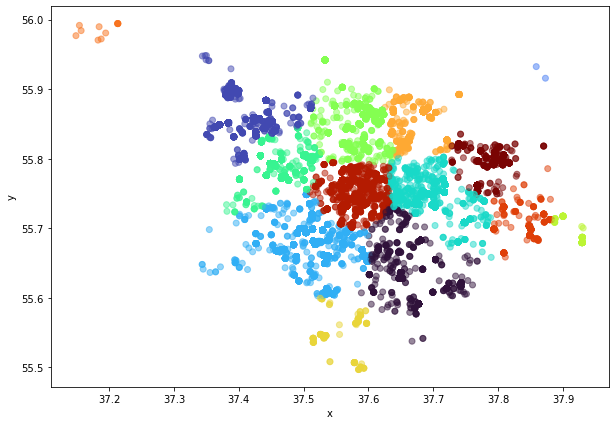

In [202]:
# модель с наибольшим silhouette score
model = Birch(n_clusters=n_clustres_best, threshold=threshold_best)
clusters = model.fit_predict(df_no)

plt.figure(figsize=(10,7))
plt.scatter(df_no.iloc[:, 0], df_no.iloc[:, 1],c=clusters, alpha=0.5, cmap='turbo')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

Количество человек, проголосовавших "против" составляет большую часть исходного датасета, и разбиение на кластеры в итоге получилось очень похожим на кластеризацию изначального датасета.